Deforested Pixels: 233363 (23.34%)
Reforested Pixels: 250069 (25.01%)
Unchanged Pixels: 516568 (51.66%)


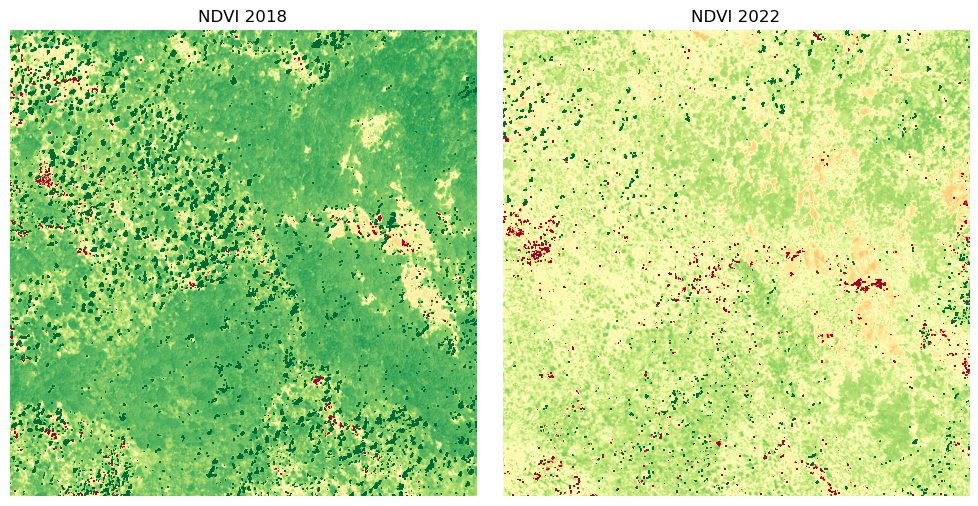

Year: 2018
Accuracy: 0.426634
Precision: 0.8596977384828127
Recall: 0.3770351676006332
F1-score: 0.5241815420618916
Confusion Matrix:
[[110812  51542]
 [521824 315822]]
Year: 2022
Accuracy: 0.616375
Precision: 0.037180722264170595
Recall: 0.5079139249510938
F1-score: 0.06928927544670475
Confusion Matrix:
[[602095 369790]
 [ 13835  14280]]


In [1]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split
import warnings
from rasterio.errors import NotGeoreferencedWarning
from sklearn.preprocessing import StandardScaler
from rasterio.windows import Window

# Suppress NotGeoreferencedWarning
warnings.simplefilter("ignore", NotGeoreferencedWarning)

# Paths to the TIFF images for different years
image_paths = {
    '2018': 'dataset/2018/m_3912112_sw_10_060_20180718.tif',
    '2022': 'dataset/2022/m_3912112_sw_10_060_20220714.tif'
}

def read_tiff_image(filename):
    """Reads the entire TIFF file."""
    with rasterio.open(filename) as src:
        image = src.read()  # Read all bands of the image
    return image

def read_tiff_subset(filename, window_size=1000):
    """
    Reads a subset of the TIFF image starting from the top-right corner.
    """
    with rasterio.open(filename) as src:
        # Calculate the column offset for the top-right corner
        col_off = src.width - window_size
        row_off = 0  # Top row remains 0

        # Create a window and read the subset
        window = Window(col_off, row_off, window_size, window_size)
        subset = src.read(window=window)
    return subset

def calculate_ndvi(nir, red):
    """Calculates NDVI using NIR and red bands."""
    return (nir.astype(float) - red.astype(float)) / (nir + red + 1e-8)

def add_texture(image, window_size=3):
    """Adds texture feature to the image."""
    from scipy.ndimage import generic_filter
    texture = generic_filter(image, np.std, size=window_size)
    return np.dstack((image, texture))


# Read subsets from all years
subsets = {year: read_tiff_subset(path) for year, path in image_paths.items()}

# # Read entire images from all years
# subsets = {year: read_tiff_image(path) for year, path in image_paths.items()}

# Calculate NDVI for all years
ndvis = {}
for year, subset in subsets.items():
    red, nir = subset[0], subset[3]  # Assuming bands are in order: R, G, B, NIR
    ndvis[year] = calculate_ndvi(nir, red)

# Prepare features and ground truth for each year
predictions = {}
ground_truths = {}

for year in ['2018', '2022']:
    rgb = np.moveaxis(subsets[year][:3], 0, -1)  # Move channels to last dimension
    features = add_texture(rgb).reshape(-1, 4)  # Reshape to (n_samples, n_features)
    
    # Create ground truth based on NDVI thresholds
    if year == '2018':
        ground_truths[year] = np.where(ndvis['2018'] > 0.3, 1, 0).ravel()  # Vegetation vs Non-vegetation
    else:
        current_year_ndvi = ndvis['2022'] > 0.3
        previous_year_ndvi = ndvis['2018'] <= 0.3
        
        # Detect change: current year NDVI > threshold AND previous year NDVI <= threshold
        ground_truths[year] = (current_year_ndvi & previous_year_ndvi).astype(int).ravel()

    # Ensure X and y have consistent lengths before training
    if ground_truths[year].size != features.shape[0]:
        min_length = min(ground_truths[year].size, features.shape[0])
        features = features[:min_length]
        ground_truths[year] = ground_truths[year][:min_length]
    
    # Scale features using StandardScaler
    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(features)

    # Train Random Forest model for each year independently
    X_train, X_test, y_train, y_test = train_test_split(features_scaled, ground_truths[year], test_size=0.2, random_state=42)
    
    rf = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=10, class_weight="balanced", n_jobs=-1)
    rf.fit(X_train, y_train)
    
    # Predict classes for the current year using the entire feature set
    predictions[year] = rf.predict(features_scaled)

# Compute change detection (e.g., from 2018 to 2022)
deforestation = (predictions['2018'] == 1) & (predictions['2022'] == 0)  # Deforestation detected
reforestation = (predictions['2018'] == 0) & (predictions['2022'] == 1)  # Reforestation detected
no_change = (predictions['2018'] == predictions['2022'])  # No change detected

# Calculate total pixels and pixel categories in the selected area of interest
total_pixels = ndvis['2018'].size
deforested_pixels = np.sum(deforestation)
reforested_pixels = np.sum(reforestation)
unchanged_pixels = np.sum(no_change)

print(f"Deforested Pixels: {deforested_pixels} ({(deforested_pixels / total_pixels) * 100:.2f}%)")
print(f"Reforested Pixels: {reforested_pixels} ({(reforested_pixels / total_pixels) * 100:.2f}%)")
print(f"Unchanged Pixels: {unchanged_pixels} ({(unchanged_pixels / total_pixels) * 100:.2f}%)")

# Visualize results of deforestation detection and NDVI images for both years
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# NDVI for 2018
axs[0].imshow(ndvis['2018'], cmap='RdYlGn', vmin=-1, vmax=1)
axs[0].set_title('NDVI 2018')
axs[0].axis('off')

# NDVI for 2022
axs[1].imshow(ndvis['2022'], cmap='RdYlGn', vmin=-1, vmax=1)
axs[1].set_title('NDVI 2022')
axs[1].axis('off')

plt.tight_layout()
plt.show()

# Print evaluation metrics for each model trained on the entire image area
for year in ['2018', '2022']:
    print(f"Year: {year}")
    print("Accuracy:", accuracy_score(ground_truths[year], predictions[year]))
    print("Precision:", precision_score(ground_truths[year], predictions[year]))
    print("Recall:", recall_score(ground_truths[year], predictions[year]))
    print("F1-score:", f1_score(ground_truths[year], predictions[year]))
    print("Confusion Matrix:")
    print(confusion_matrix(ground_truths[year], predictions[year]))

In [1]:
# Cell 1: Imports and Setup
import rasterio
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split
import warnings
from rasterio.errors import NotGeoreferencedWarning
from sklearn.preprocessing import StandardScaler
from rasterio.windows import Window
from scipy.ndimage import generic_filter

# Suppress NotGeoreferencedWarning
warnings.simplefilter("ignore", NotGeoreferencedWarning)

# # Paths to the TIFF images for different years
image_paths = {
    '2018': 'dataset/2018/m_3912112_sw_10_060_20180718.tif',
    '2022': 'dataset/2022/m_3912112_sw_10_060_20220714.tif'
}

# Paths to the TIFF images for different years
# image_paths = {
#     '2018': '2018_subset.tif',
#     '2022': '2022_subset.tif'
# }

In [3]:
# Cell 2: Helper Functions
# def read_tiff_subset(filename, window_size=500):
#     """
#     Reads a subset of the TIFF image starting from the top-right corner.
#     """
#     with rasterio.open(filename) as src:
#         col_off = src.width - window_size
#         row_off = 0
#         window = Window(col_off, row_off, window_size, window_size)
#         subset = src.read(window=window)
#     return subset


def read_tiff(filename):
    """
    Reads the entire TIFF image.
    """
    with rasterio.open(filename) as src:
        image = src.read()
    return image

def calculate_ndvi(nir, red):
    """Calculates NDVI using NIR and red bands."""
    return (nir.astype(float) - red.astype(float)) / (nir + red + 1e-8)

def add_texture(image, window_size=3):
    """Adds texture feature to the image."""
    texture = generic_filter(image, np.std, size=window_size)
    return np.dstack((image, texture))

In [ ]:
# Cell 3: Data Preparation
# Read subsets from all years
subsets = {year: read_tiff(path) for year, path in image_paths.items()}

# Calculate NDVI for all years
ndvis = {}
for year, subset in subsets.items():
    red, nir = subset[0], subset[3]  # Assuming bands are in order: R, G, B, NIR
    ndvis[year] = calculate_ndvi(nir, red)

# Prepare features and ground truth for each year
predictions = {}
ground_truths = {}

for year in ['2018', '2022']:
    rgb = np.moveaxis(subsets[year][:3], 0, -1)
    features = add_texture(rgb).reshape(-1, 4)
    
    if year == '2018':
        ground_truths[year] = np.where(ndvis['2018'] > 0.3, 1, 0).ravel()
    else:
        current_year_ndvi = ndvis['2022'] > 0.3
        previous_year_ndvi = ndvis['2018'] <= 0.3
        ground_truths[year] = (current_year_ndvi & previous_year_ndvi).astype(int).ravel()

    min_length = min(ground_truths[year].size, features.shape[0])
    features = features[:min_length]
    ground_truths[year] = ground_truths[year][:min_length]
    
    # scaler = StandardScaler()
    # features_scaled = scaler.fit_transform(features)

    # X_train, X_test, y_train, y_test = train_test_split(features_scaled, ground_truths[year], test_size=0.2, random_state=42)
    
    # # Random Forest
    # rf = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=10, class_weight="balanced", n_jobs=-1)
    # rf.fit(X_train, y_train)
    # predictions[f'{year}_rf'] = rf.predict(features_scaled)

    # # Gradient Boosting
    # from sklearn.utils.class_weight import compute_sample_weight
    # # Compute sample weights to balance classes
    # sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)
    # gb = GradientBoostingClassifier(n_estimators=100, random_state=42, max_depth=10)
    # gb.fit(X_train, y_train, sample_weight=sample_weights)
    # predictions[f'{year}_gb'] = gb.predict(features_scaled)

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x75b6d918ba10>>
Traceback (most recent call last):
  File "/home/acharyp/anaconda3/envs/remote_sensing_change_detection/lib/python3.12/site-packages/ipykernel/ipkernel.py", line 790, in _clean_thread_parent_frames
    active_threads = {thread.ident for thread in threading.enumerate()}
                                                 ^^^^^^^^^^^^^^^^^^^^^
  File "/home/acharyp/anaconda3/envs/remote_sensing_change_detection/lib/python3.12/threading.py", line 1541, in enumerate
    with _active_limbo_lock:
SystemError: <built-in method __enter__ of _thread.RLock object at 0x75b6db812200> returned a result with an exception set
Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x75b6d918ba10>>
Traceback (most recent call last):
  File "/home/acharyp/anaconda3/envs/remote_sensing_change_detect

Random Forest Results:
Deforested Pixels: 153694 (61.48%)
Reforested Pixels: 10359 (4.14%)
Unchanged Pixels: 85947 (34.38%)

Gradient Boosting Results:
Deforested Pixels: 171514 (68.61%)
Reforested Pixels: 8496 (3.40%)
Unchanged Pixels: 69990 (28.00%)


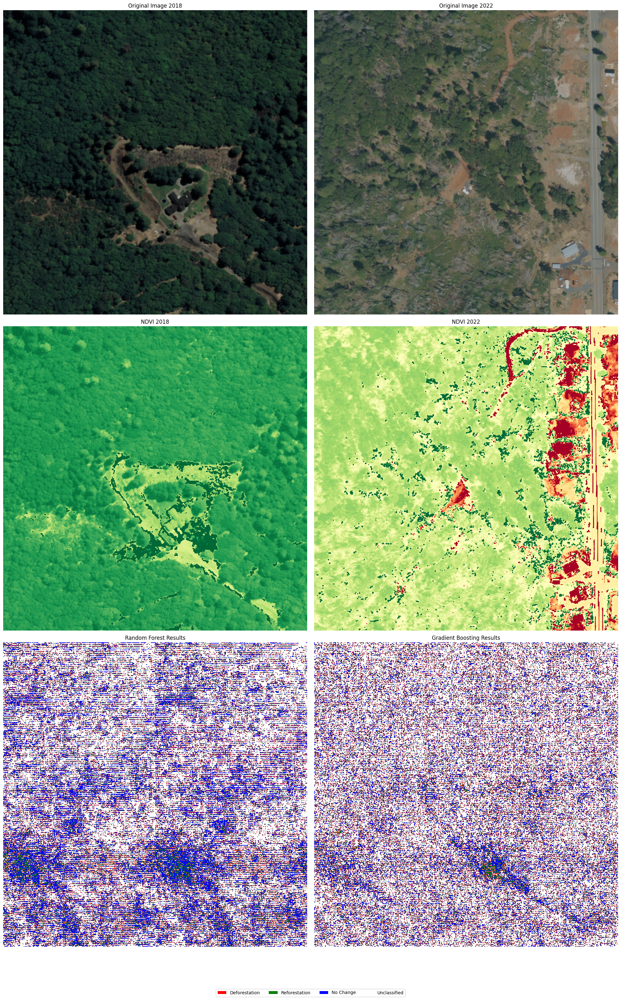

In [49]:
# Cell 4: Change Detection and Visualization
# Compute change detection (e.g., from 2018 to 2022)
deforestation_rf = (predictions['2018_rf'] == 1) & (predictions['2022_rf'] == 0)
reforestation_rf = (predictions['2018_rf'] == 0) & (predictions['2022_rf'] == 1)
no_change_rf = (predictions['2018_rf'] == predictions['2022_rf'])

deforestation_gb = (predictions['2018_gb'] == 1) & (predictions['2022_gb'] == 0)
reforestation_gb = (predictions['2018_gb'] == 0) & (predictions['2022_gb'] == 1)
no_change_gb = (predictions['2018_gb'] == predictions['2022_gb'])

# Calculate total pixels and pixel categories
total_pixels = ndvis['2018'].size

print("Random Forest Results:")
print(f"Deforested Pixels: {np.sum(deforestation_rf)} ({(np.sum(deforestation_rf) / total_pixels) * 100:.2f}%)")
print(f"Reforested Pixels: {np.sum(reforestation_rf)} ({(np.sum(reforestation_rf) / total_pixels) * 100:.2f}%)")
print(f"Unchanged Pixels: {np.sum(no_change_rf)} ({(np.sum(no_change_rf) / total_pixels) * 100:.2f}%)")

print("\nGradient Boosting Results:")
print(f"Deforested Pixels: {np.sum(deforestation_gb)} ({(np.sum(deforestation_gb) / total_pixels) * 100:.2f}%)")
print(f"Reforested Pixels: {np.sum(reforestation_gb)} ({(np.sum(reforestation_gb) / total_pixels) * 100:.2f}%)")
print(f"Unchanged Pixels: {np.sum(no_change_gb)} ({(np.sum(no_change_gb) / total_pixels) * 100:.2f}%)")

fig, axs = plt.subplots(3, 2, figsize=(20, 30))

# Plot original images
axs[0, 0].imshow(np.moveaxis(subsets['2018'][:3], 0, -1))
axs[0, 0].set_title('Original Image 2018')
axs[0, 0].axis('off')

axs[0, 1].imshow(np.moveaxis(subsets['2022'][:3], 0, -1))
axs[0, 1].set_title('Original Image 2022')
axs[0, 1].axis('off')

# Plot NDVI images
axs[1, 0].imshow(ndvis['2018'], cmap='RdYlGn', vmin=-1, vmax=1)
axs[1, 0].set_title('NDVI 2018')
axs[1, 0].axis('off')

axs[1, 1].imshow(ndvis['2022'], cmap='RdYlGn', vmin=-1, vmax=1)
axs[1, 1].set_title('NDVI 2022')
axs[1, 1].axis('off')

# Plot Random Forest results
rf_result = np.zeros(ndvis['2018'].shape, dtype=int)
rf_result[deforestation_rf.reshape(ndvis['2018'].shape)] = 1  # Red for deforestation
rf_result[reforestation_rf.reshape(ndvis['2018'].shape)] = 2  # Green for reforestation
rf_result[no_change_rf.reshape(ndvis['2018'].shape)] = 3  # Blue for no change

axs[2, 0].imshow(rf_result, cmap=plt.cm.colors.ListedColormap(['white', 'red', 'green', 'blue']))
axs[2, 0].set_title('Random Forest Results')
axs[2, 0].axis('off')

# Plot Gradient Boosting results
gb_result = np.zeros(ndvis['2018'].shape, dtype=int)
gb_result[deforestation_gb.reshape(ndvis['2018'].shape)] = 1  # Red for deforestation
gb_result[reforestation_gb.reshape(ndvis['2018'].shape)] = 2  # Green for reforestation
gb_result[no_change_gb.reshape(ndvis['2018'].shape)] = 3  # Blue for no change

axs[2, 1].imshow(gb_result, cmap=plt.cm.colors.ListedColormap(['white', 'red', 'green', 'blue']))
axs[2, 1].set_title('Gradient Boosting Results')
axs[2, 1].axis('off')

# Add a common legend
legend_elements = [plt.Rectangle((0,0),1,1, facecolor='red', edgecolor='none', label='Deforestation'),
                   plt.Rectangle((0,0),1,1, facecolor='green', edgecolor='none', label='Reforestation'),
                   plt.Rectangle((0,0),1,1, facecolor='blue', edgecolor='none', label='No Change'),
                   plt.Rectangle((0,0),1,1, facecolor='white', edgecolor='none', label='Unclassified')]

fig.legend(handles=legend_elements, loc='lower center', ncol=4, bbox_to_anchor=(0.5, -0.05))

plt.tight_layout()
plt.show()

#Areas that were not forest in either year (e.g., water bodies, urban areas, or bare soil)

In [50]:
# Cell 5: Model Evaluation
def print_metrics(y_true, y_pred, model_name):
    print(f"Model: {model_name}")
    print("Accuracy:", accuracy_score(y_true, y_pred))
    print("Precision:", precision_score(y_true, y_pred))
    print("Recall:", recall_score(y_true, y_pred))
    print("F1-score:", f1_score(y_true, y_pred))
    print("Confusion Matrix:")
    print(confusion_matrix(y_true, y_pred))
    print("\n")

for year in ['2018', '2022']:
    print(f"Year: {year}")
    print_metrics(ground_truths[year], predictions[f'{year}_rf'], "Random Forest")
    print_metrics(ground_truths[year], predictions[f'{year}_gb'], "Gradient Boosting")

Year: 2018
Model: Random Forest
Accuracy: 0.873084
Precision: 0.9842871440269311
Recall: 0.8844224802874416
F1-score: 0.9316864063936476
Confusion Matrix:
[[  1905   3454]
 [ 28275 216366]]


Model: Gradient Boosting
Accuracy: 0.835988
Precision: 0.9908075120991844
Recall: 0.8401903196929378
F1-score: 0.9093040591205792
Confusion Matrix:
[[  3452   1907]
 [ 39096 205545]]


Year: 2022
Model: Random Forest
Accuracy: 0.695768
Precision: 0.016133882460613192
Recall: 0.6046055854973053
F1-score: 0.03142908081399791
Confusion Matrix:
[[172708  75251]
 [   807   1234]]


Model: Gradient Boosting
Accuracy: 0.827356
Precision: 0.03729126344691002
Recall: 0.8118569328760411
F1-score: 0.07130715438407746
Confusion Matrix:
[[205182  42777]
 [   384   1657]]




Original image dimensions: 9610 x 12210
Subset dimensions: 1601 x 2035
Subset saved to 2018_subset.tif


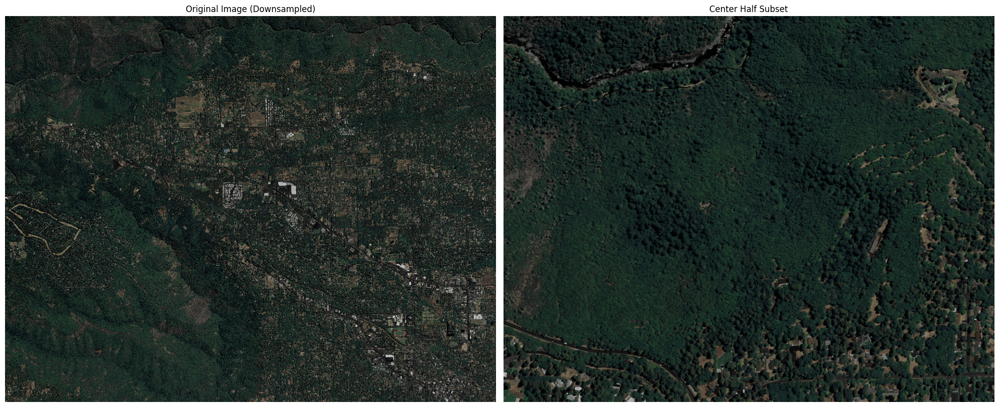

Original image dimensions: 12370 x 9770
Subset dimensions: 2061 x 1628
Subset saved to 2022_subset.tif


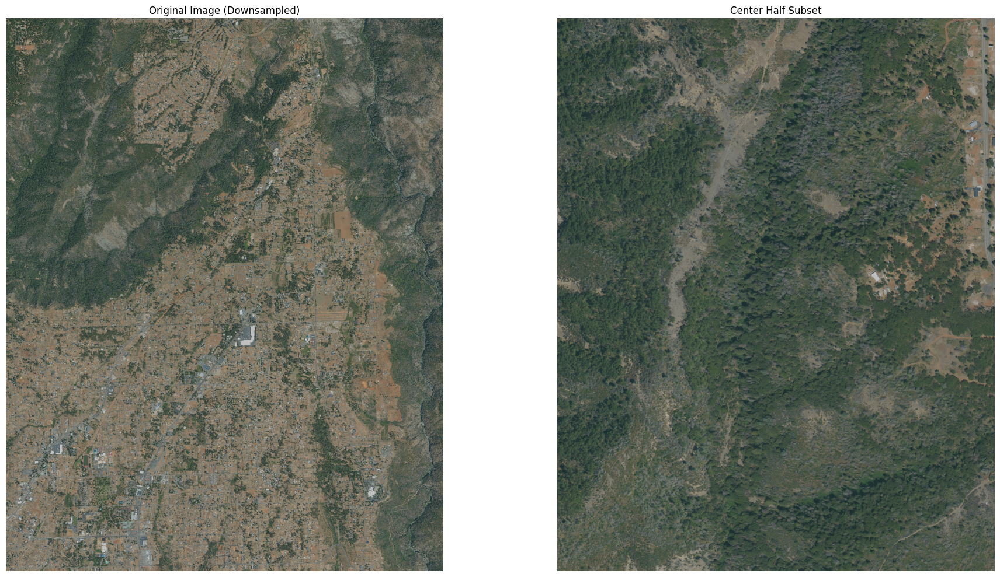

Original image dimensions: 12370 x 9770
Subset dimensions: 2061 x 1628
Subset saved to 2020_subset.tif


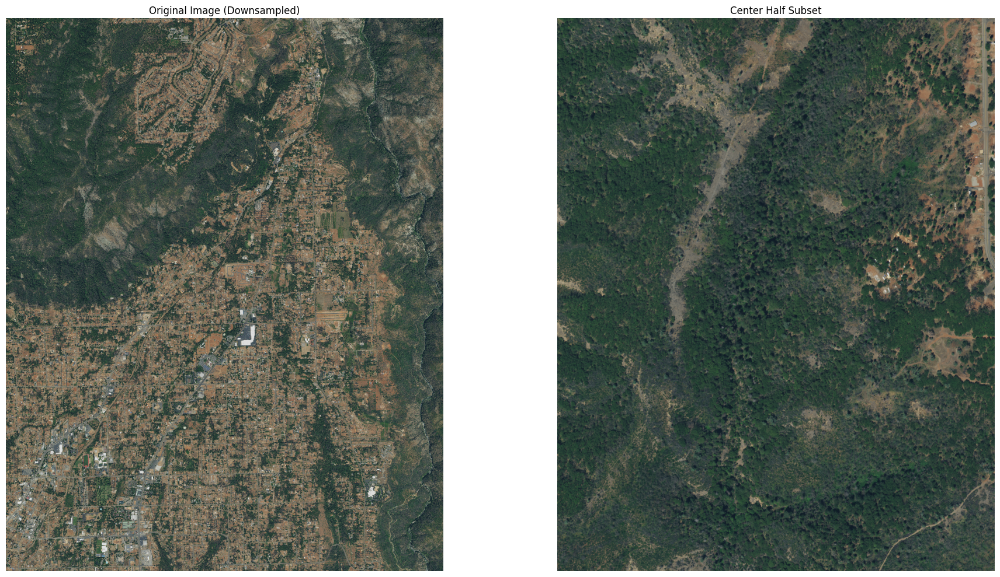

In [51]:
import rasterio
from rasterio.windows import Window
import matplotlib.pyplot as plt
import numpy as np

def extract_center_half(input_filename, output_filename):
    with rasterio.open(input_filename) as src:
        # Get dimensions
        height = src.height
        width = src.width
        
        print(f"Original image dimensions: {height} x {width}")

        # Calculate dimensions for center half
        half_height = height // 6
        half_width = width // 6

        # Calculate starting point for center window
        start_row = (height - half_height) // 6
        start_col = (width - half_width) // 6

        # Create window for center half
        window = Window(start_col, start_row, half_width, half_height)

        # Read the subset
        center_half = src.read(window=window)

        # Read full image (downsampled for plotting)
        downsample_factor = max(1, width // 1000)
        full_img = src.read(out_shape=(src.count, 
                                       int(height // downsample_factor), 
                                       int(width // downsample_factor)))

        # Update transform and profile for new subset
        transform = src.window_transform(window)
        profile = src.profile.copy()
        profile.update({
            'height': half_height,
            'width': half_width,
            'transform': transform
        })

        # Write subset to new file
        with rasterio.open(output_filename, 'w', **profile) as dst:
            dst.write(center_half)

    print(f"Subset dimensions: {center_half.shape[1]} x {center_half.shape[2]}")
    print(f"Subset saved to {output_filename}")

    # Plotting
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

    # Plot original image
    if full_img.shape[0] >= 3:
        rgb = np.dstack((full_img[0], full_img[1], full_img[2]))
    else:
        rgb = full_img[0]
    ax1.imshow(rgb)
    ax1.set_title('Original Image (Downsampled)')
    ax1.axis('off')

    # Plot center half subset
    if center_half.shape[0] >= 3:
        rgb_subset = np.dstack((center_half[0], center_half[1], center_half[2]))
    else:
        rgb_subset = center_half[0]
    ax2.imshow(rgb_subset)
    ax2.set_title('Center Half Subset')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

    return center_half

# Example usage:
input_file = 'dataset/2018/2018.tif'
output_file = '2018_subset.tif'
subset = extract_center_half(input_file, output_file)

input_file = 'dataset/2022/2022.tif'
output_file = '2022_subset.tif'
subset = extract_center_half(input_file, output_file)

input_file = 'dataset/2020/2020.tif'
output_file = '2020_subset.tif'
subset = extract_center_half(input_file, output_file)